# SEGMENTACIÓN DE NUBES DE PUNTOS BASADA EN COLOR y K-MEANS EN PYTHON 
**Autores: Darío Solano, Brenda Ortíz y Josué García. División de Ingeniería en Ciencias de la Tierra, Facultad de ingeniería, UNAM, 2021.**
**Contacto: dsolano@unam.mx, dario.e.solano@gmail.com**
<br> Notebook disponible para descarga en: https://github.com/dariosolano/cloud_points
<br>Visualización en línea disponible en: 

## Introducción

Las nubes de puntos se generan a partir de fotografías de un objeto observado desde diferentes posiciones conocidas de observación. Como resultado, las nubes de puntos contienen información de posición de un objeto, ya sean relativas o absolutas. Además, las nubes de puntos contienen información de otros atributos como el color.

Al analizar una nube de puntos en el espacio del color, es posible observar agrupamientos que corresponden a condiciones similares de iluminación y composición de las rocas. Por lo tanto, es posible hacer una separación o agrupamiento de puntos de una nube con características de color similares. Del mismo modo, se pueden llegar a separar grupos de puntos que reflejan comportamientos distintivos de las rocas. Sin embargo, es importante siempre tener en mente las limitaciones de las nubes de puntos para no llegar a interpretaciones equivocadas. 

El color de cada uno de los puntos de una nube estará determinado por diferentes factores, entre los cuales destacan los materiales de los objetos, el equipo utilizado para adquirir las fotografías y la iluminación. El material de los objetos generalmente no se puede controlar. Las características del equipo tampoco se pueden controlar fácilmente sin invertir económicamente. La iluminación depende de la fuente de luz, pero en general es el sol, y por lo tanto es cambiante a lo largo del día.

En este ejericio vamos a utilizar el atributo de color que cada uno de los puntos de una nubes de tiene asociado. ello vamos a utilizar una técnica de segmentación (o clasificación) conocida como K-means, la cual es una de las herramientas más populares para clasificaciones no supervisadas en machine learning.  

Para la realización de este ejercicio vamos a utilizar numpy, matplotlib y sklearn.

## Importación de librerías y lectura de datos

In [1]:
#%matplotlib notebook
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
matplotlib.rcParams['figure.figsize'] = [14, 9]
matplotlib.rcParams['figure.dpi'] = 400

## Conociendo la nube de puntos

In [2]:
file_data_path1='/Users/dario/Downloads/xyz_subset.npy'
file_data_path2='/Users/dario/Downloads/rgb_subset.npy'

In [3]:
xyz= np.load(file_data_path1)
rgb= np.load(file_data_path2)

In [4]:
print("shape xyz: ", xyz.shape) #la dimensión en filas x columnas de xyz
print("shape rgb:", rgb.shape) #la dimensión en filas x columnas de rgb

shape xyz:  (260478, 3)
shape rgb: (260478, 3)


In [5]:
print("\nHay ", xyz.shape[0], "puntos en esta nube de puntos de ejemplo!\n"  ) #el número total de elementos 


Hay  260478 puntos en esta nube de puntos de ejemplo!



In [6]:
print(xyz[0, :])  # first row of x2

[ 479328.4409 2137892.5978    2284.5623]


## Visualizaciones con scatter en 3D

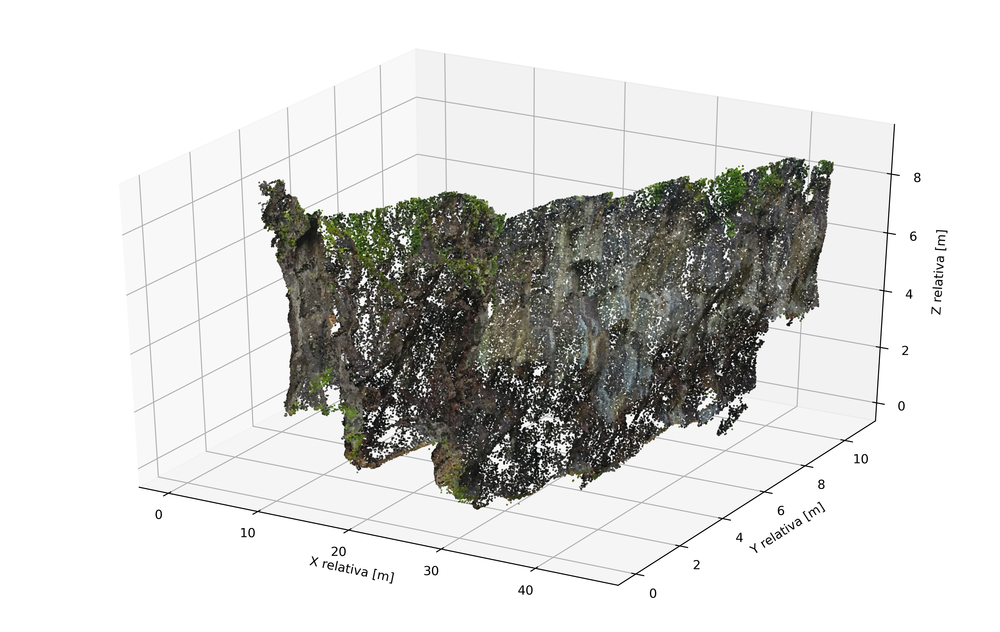

In [7]:
ax = plt.axes(projection='3d')
ax.scatter(xyz[:,0]-np.min(xyz[:,0]),xyz[:,1]-np.min(xyz[:,1]), xyz[:,2]-np.min(xyz[:,2]),'.',c=rgb/255, s=0.2, alpha=0.9)
ax.set_xlabel('X relativa [m]')
ax.set_ylabel('Y relativa [m]')
ax.set_zlabel('Z relativa [m]')
plt.savefig('CCA_wall.png', bbox_inches='tight')

## Análisis básico de los valores en los canales RGB 

### Histogramas

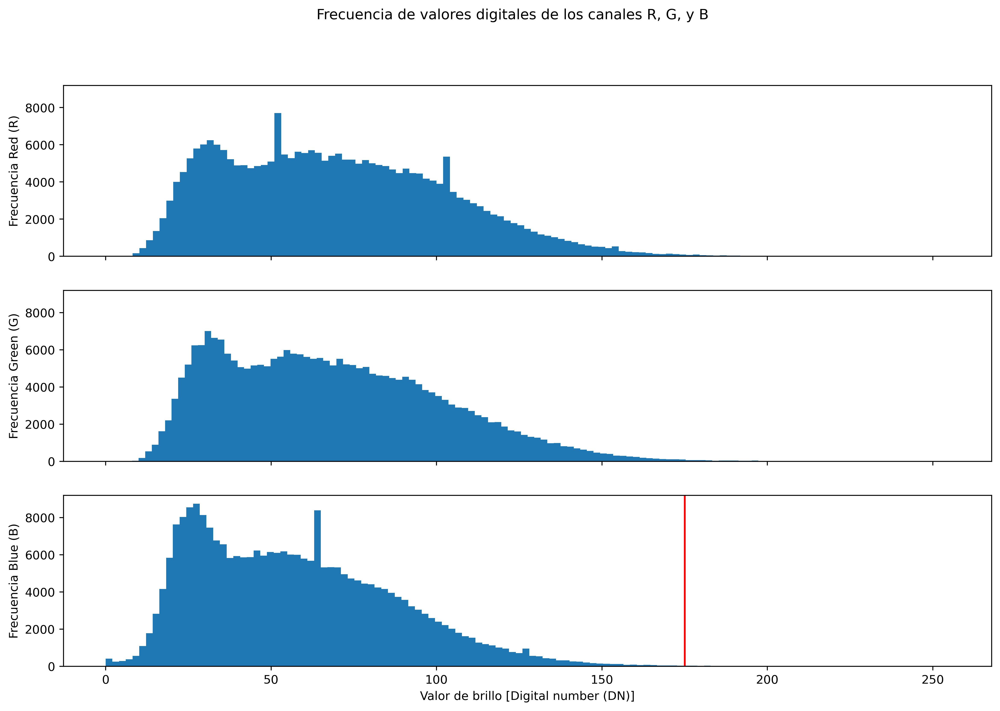

In [8]:
fig, axs = plt.subplots(3, sharex=True, sharey=True)
fig.suptitle('Frecuencia de valores digitales de los canales R, G, y B')
axs[0].hist(rgb[:,0], bins = 125);
axs[0].set_ylabel('Frecuencia Red (R)')
axs[1].hist(rgb[:,1], bins = 125);
axs[1].set_ylabel('Frecuencia Green (G)')
axs[2].hist(rgb[:,2], bins = 125);
axs[2].set_ylabel('Frecuencia Blue (B)')
plt.xlabel('Valor de brillo [Digital number (DN)]')
plt.axvline(x=175,color='red')

### Espacio de color RGB

(0.0, 175.0)

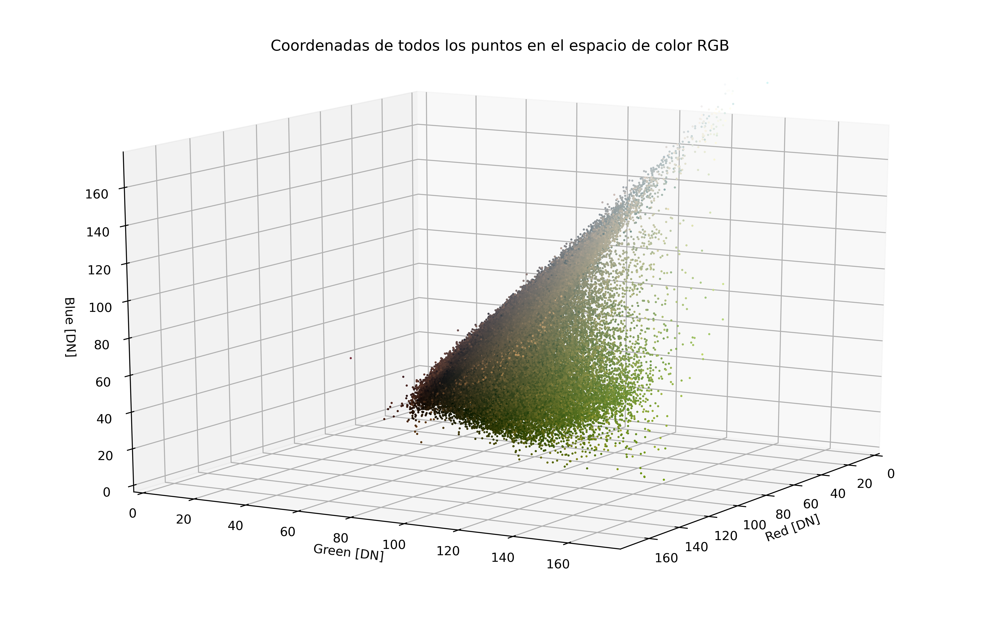

In [9]:
ax = plt.axes(projection='3d')
plt.title('Coordenadas de todos los puntos en el espacio de color RGB')
ax.scatter(rgb[:,0],rgb[:,1], rgb[:,2],'o',c=rgb/255, s=0.5, alpha=1)
ax.view_init(elev=15., azim=30)
ax.set_xlabel('Red [DN]')
ax.set_ylabel('Green [DN]')
ax.set_zlabel('Blue [DN]')
ax.set_xlim([0, 175])
ax.set_ylim([0, 175])
ax.set_zlim([0, 175])

## Clasificación de la nube de puntos usando el método de K-means

### Implementación del método de K-means

In [10]:
from sklearn.cluster import KMeans

km = KMeans(
    n_clusters=5, init='random',
    n_init=10, max_iter=3000, 
    tol=1e-04, random_state=0
)
y_km = km.fit_predict(rgb)
centroids =km.cluster_centers_

print (y_km)
print(y_km.shape)
print(xyz.shape)
print(rgb.shape)

[1 1 4 ... 2 4 2]
(260478,)
(260478, 3)
(260478, 3)


### Etiquetado de datos en el espacio de color RGB

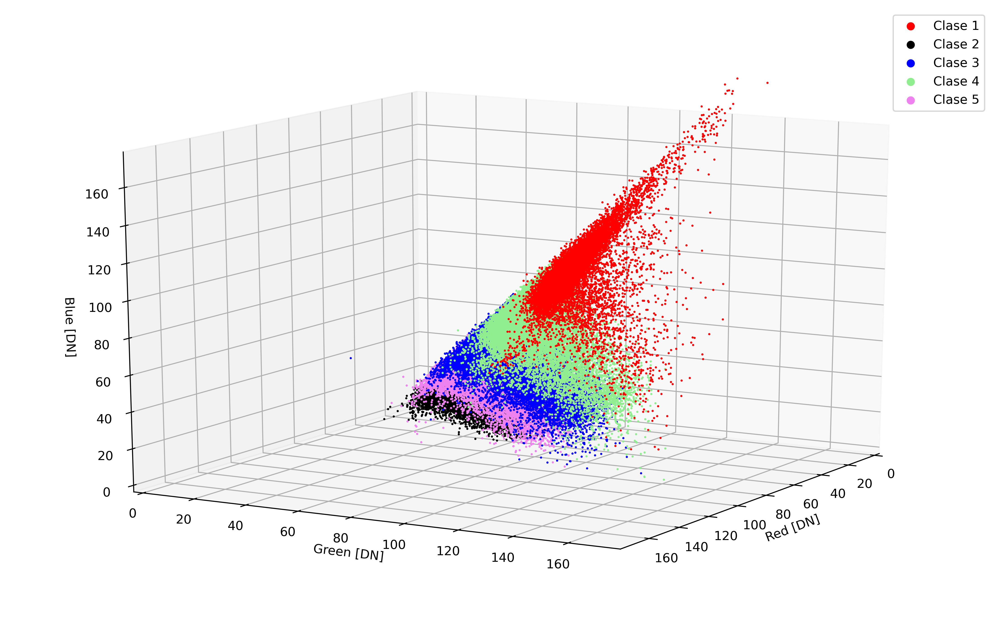

In [11]:
ax = plt.axes(projection='3d')

ax.scatter(rgb[y_km == 0,0],rgb[y_km == 0,1], rgb[y_km == 0,2],'o',c='red', s=0.5, alpha=1, label='Clase 1')
ax.scatter(rgb[y_km == 1,0],rgb[y_km == 1,1], rgb[y_km == 1,2],'o',c='black', s=0.5, alpha=1, label='Clase 2')
ax.scatter(rgb[y_km == 2,0],rgb[y_km == 2,1], rgb[y_km == 2,2],'o',c='blue', s=0.5, alpha=1, label='Clase 3')
ax.scatter(rgb[y_km == 3,0],rgb[y_km == 3,1], rgb[y_km == 3,2],'o',c='lightgreen', s=0.5, alpha=1, label='Clase 4')
ax.scatter(rgb[y_km == 4,0],rgb[y_km == 4,1], rgb[y_km == 4,2],'o',c='violet', s=0.5, alpha=1, label='Clase 5')

ax.view_init(elev=15., azim=30)
ax.set_xlabel('Red [DN]')
ax.set_ylabel('Green [DN]')
ax.set_zlabel('Blue [DN]')
ax.set_xlim([0, 175])
ax.set_ylim([0, 175])
ax.set_zlim([0, 175])
lgnd=ax.legend()
for handle in lgnd.legendHandles:
    handle.set_sizes([30.0])

### Visualización de los centroides

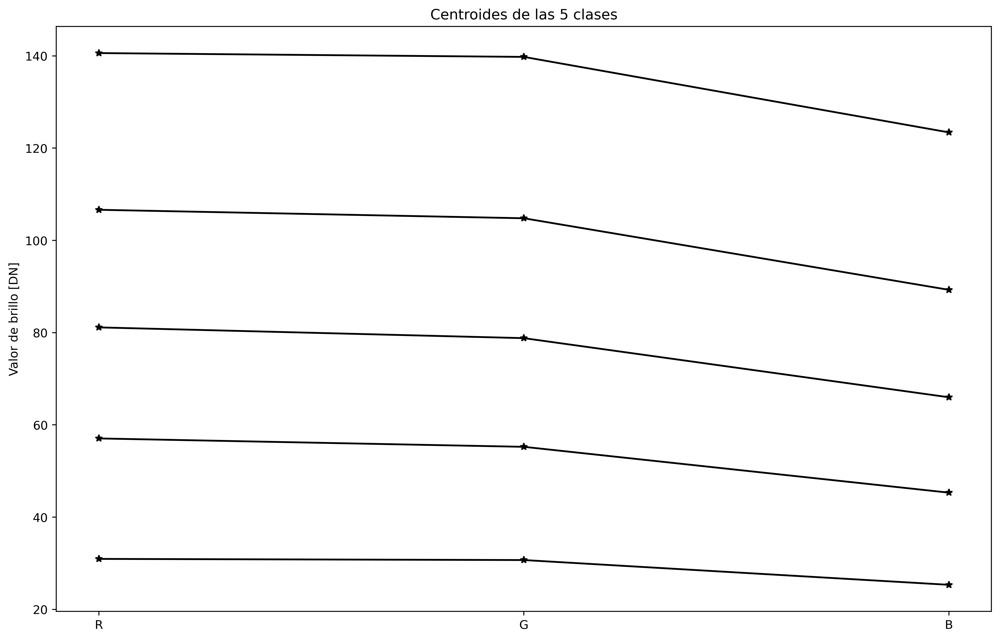

In [12]:
ax = plt.axes()
ax.plot(centroids.transpose(), c='black', marker='*')
centroids.shape
ax.set_xticks([0, 1, 2]);
ax.set_xticklabels(['R', 'G','B']);
ax.set_ylabel('Valor de brillo [DN]')
plt.title('Centroides de las 5 clases');

### Etiquetado de datos en el espacio XYZ

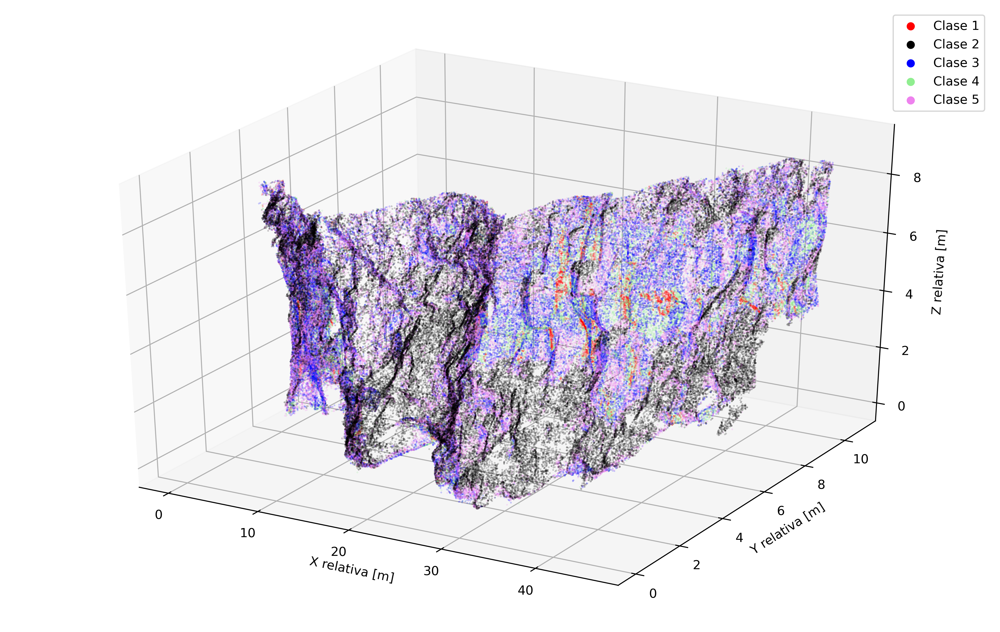

In [13]:
ax = plt.axes(projection='3d')
ax.scatter(xyz[y_km == 0,0]-np.min(xyz[:,0]),xyz[y_km == 0,1]-np.min(xyz[:,1]), xyz[y_km == 0,2]-np.min(xyz[:,2]),'.',c='red', s=0.01, alpha=1)
ax.scatter(xyz[y_km == 1,0]-np.min(xyz[:,0]),xyz[y_km == 1,1]-np.min(xyz[:,1]), xyz[y_km == 1,2]-np.min(xyz[:,2]),'.',c='black', s=0.01, alpha=1)
ax.scatter(xyz[y_km == 2,0]-np.min(xyz[:,0]),xyz[y_km == 2,1]-np.min(xyz[:,1]), xyz[y_km == 2,2]-np.min(xyz[:,2]),'.',c='blue', s=0.01, alpha=1)
ax.scatter(xyz[y_km == 3,0]-np.min(xyz[:,0]),xyz[y_km == 3,1]-np.min(xyz[:,1]), xyz[y_km == 3,2]-np.min(xyz[:,2]),'.',c='lightgreen', s=0.01, alpha=1)
ax.scatter(xyz[y_km == 4,0]-np.min(xyz[:,0]),xyz[y_km == 4,1]-np.min(xyz[:,1]), xyz[y_km == 4,2]-np.min(xyz[:,2]),'.',c='violet', s=0.01, alpha=1)
ax.set_xlabel('X relativa [m]')
ax.set_ylabel('Y relativa [m]')
ax.set_zlabel('Z relativa [m]')
lgnd=ax.legend(['Clase 1','Clase 2','Clase 3', 'Clase 4','Clase 5'])
for handle in lgnd.legendHandles:
    handle.set_sizes([30.0])    
plt.savefig('classified_all.png', bbox_inches='tight')

### Extracción de una clase de interés

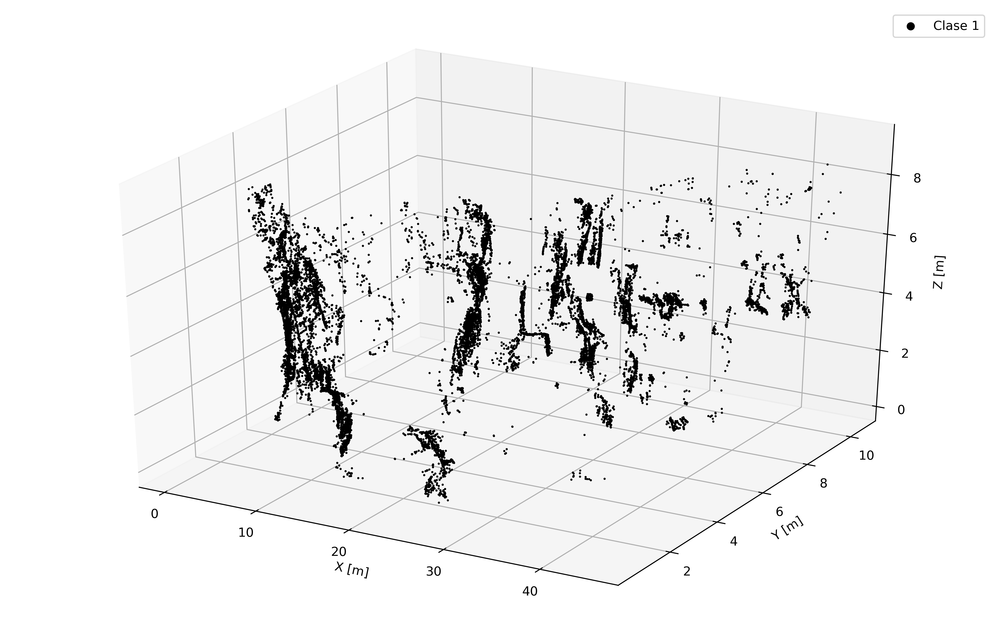

In [20]:
ax = plt.axes(projection='3d')
cofi=0; #class of interest
ax.scatter(xyz[y_km == cofi,0]-np.min(xyz[:,0]),xyz[y_km == cofi,1]-np.min(xyz[:,1]), xyz[y_km == cofi,2]-np.min(xyz[:,2]),'o',c='black', s=0.5, alpha=1)
ax.set_xlabel('X [m]')
ax.set_ylabel('Y [m]')
ax.set_zlabel('Z [m]')
lgnd=ax.legend(['Clase 1'])
for handle in lgnd.legendHandles:
    handle.set_sizes([30.0])
plt.savefig('classified_class2.png', bbox_inches='tight')


## Para guardar los puntos que corresponden a la Clase 1

In [22]:
np.save('xyz_subset_class1', xyz[y_km == cofi,:])

### Determinación de el número adecuado de clases

In [ ]:
# calculate distortion for a range of number of cluster
distortions = []
for i in range(1, 11):
    km = KMeans(
        n_clusters=i, init='random',
        n_init=10, max_iter=300,
        tol=1e-04, random_state=0
    )
    km.fit(rgb)
    distortions.append(km.inertia_)

# plot
plt.plot(range(1, 11), distortions, marker='o')
plt.xlabel('Number of clusters');
plt.ylabel('Distortion');

Referencias

Canal de Youtube de Darío: https://www.youtube.com/channel/UCmeMXDwmAyZfmgi3ZiXffYw

1. scikit-learn: machine learning in Python — scikit-learn 0.16.1 documentation. (2021). Retrieved 3 March 2021, from https://scikit-learn.org/
2. Poux, F. (2021). Fundamentals to clustering high-dimensional data (3D point clouds). Retrieved 3 March 2021, from https://towardsdatascience.com/fundamentals-to-clustering-high-dimensional-data-3d-point-clouds-3196ee56f5da
3. Poux, F., Neuville, R., Nys, G., & Billen, R. (2018). 3D Point Cloud Semantic Modelling: Integrated Framework for Indoor Spaces and Furniture. Remote Sensing, 10(9), 1412. doi: 10.3390/rs10091412

